# Capston Project - Predicting Road Traffic Accident Severity

### Applied Data Science Capstone by IBM/Coursera

---

## Table of Contents

1. Introduction
2. Data
3. Data Pre-Processing
4. Importing Data
6. Yearly Incidents
5. References

# 1. Introduction

As the world progresses to a more and more advanced state the number of cars on the road are also increasing. Whether you are looking at first world countries or third world countries the number of vehicles year on year are increasing as households are able to afford more. With this in mind a very serious topic comes to light, according to an article by the WHO "Road traffic injuries are estimated to be the eighth leading cause of death globally for all age groups and the leading cause of death for children and young people 5–29 years of age. More people now die in road traffic crashes than from HIV/AIDS".<sup>1</sup>

The purpose of this project is to bring to light the factors that highly affect the chances of getting into a car accident and to encourage safe driving in the volatile conditions to reduce the risk factors. The data we have will help us better understand the severity of accidents in various conditions as well as the weather conditions that contribute to the accidents.

Government bodies would be very interested in the accurate predictions of the severity of an accident, to help them reduce the response times of medical staff as well as properly allocate the resources where needed to boost awareness of risk factors i.e. increase in signage, road repairs etc

# 2. Data

The original data for this project is uploaded to the following kaggle, it is provided by the IBM coursera and an untouched version of the data will be uploaded to the github account.
In another notebook I have begun preparing the data that I will be using so that we have the most relevant features for the prediction of // traffic accident severity. 
There are 194,673 accident records and 38 variables in our data set which cover the years 2004 to 2020.

Objectives

 - Review the data inorder to understand patterns and trends
 - Model the prediction using different algorithms and compare results.
 - Conclude with which factors may have more impact on accidents


# 3. Data Pre-Processing

Before I start to run any algorithms on the data we need to first go through and ensure that some preprocessing is done first. In this part, data will be cleaned so there is no missing or unusual value. The goal is that the data is the best possible before applying the algorithms.
The preprocessing of the data has been started in the <a href="https://github.com/h-patel501/Coursera_Capstone/blob/main/Features%20Selection%20&%20Preprocessing.ipynb" target="_top">Feature Selection & Preprocessing </a> file, at each stage the process is highlighted giving a short understanding of how the data will be changed.

Even though a majority of the preprocessing has been carried out some stages of the preprocessing will be carried out within this notebook.

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns

import matplotlib.pyplot as plt

## 4. Importing Data

In [2]:
Collisions = pd.read_csv('Cleansed_Collisions6.csv', low_memory=False)

The file that is being used is the cleansed version of the collisions file, where we have gone through and removed features that were unnecessary.
The reason for approaching the data in this manner is to have a very organic point of reference an example of this would be the following columns 'VEHCOUNT','PEDCOUNT','ROADCOND','WEATHER' and 'LIGHTCOND'.
All of these columns had around 3% of missing data which has been filled using a new variable 'NA', without this we would not be aware of the number of incidents that have been left without any proper documentation and so it would create a sense of bias towards prefereable outcomes.

Once these columns had been properly counted and checked we ran through the rest of the columns replacing the values for 'Unknown', 'Other' with NaN. At first I though that having an idea of unknown or other values would be helpful in knowing the scale of incidents that were not recorded properly but then we would not be able to meet the objective of the project which is to accurately predict the severity of an accident.
After some thought  I decided it would be best to replace the NA values I had introduced in the above columns to NaN to be uniform.

In [3]:
# Check to see which columns contain null values
Collisions.isnull().any()

Unnamed: 0        False
SEVERITYCODE      False
X                 False
Y                 False
OBJECTID          False
INCKEY            False
COLDETKEY         False
REPORTNO          False
STATUS            False
ADDRTYPE          False
INTKEY             True
LOCATION          False
EXCEPTRSNCODE      True
EXCEPTRSNDESC      True
SEVERITYDESC      False
COLLISIONTYPE      True
PERSONCOUNT       False
PEDCOUNT          False
PEDCYLCOUNT       False
VEHCOUNT          False
INCDATE           False
INCDTTM           False
JUNCTIONTYPE       True
SDOT_COLCODE      False
SDOT_COLDESC      False
INATTENTIONIND     True
UNDERINFL          True
WEATHER            True
ROADCOND           True
LIGHTCOND          True
PEDROWNOTGRNT      True
SDOTCOLNUM         True
SPEEDING           True
ST_COLCODE         True
ST_COLDESC         True
SEGLANEKEY        False
CROSSWALKKEY      False
HITPARKEDCAR      False
dtype: bool

### Balancing The Dataset

In [4]:
#shuffling and creating a balanced dataset with the 
df_Col1= Collisions.sample(frac=1,random_state=0,replace=False)

# 1 - Put all severity code 2 class in a separate dataset.
df_scode2 = Collisions.loc[Collisions['SEVERITYCODE'] == 2]

# 2 - Randomly select 57118 observations from the severity code 1(majority class)
df_scode1 = Collisions.loc[Collisions['SEVERITYCODE'] == 1].sample(n=57118,random_state=42)

# 3 - concatenating datasets to get balanced dataset
df_balanced = pd.concat([df_scode1,df_scode2])
df_balanced = df_balanced.sample(frac=1,random_state=0,replace=False)

#Replacing 0 with N and 1 with Y as this column has mixed datatype values, making it consistent
df_balanced['UNDERINFL'] = df_balanced['UNDERINFL'].replace(['0'],'N')
df_balanced['UNDERINFL'] = df_balanced['UNDERINFL'].replace(['1'],'Y')
# Replacing Y with 1 and fill the NaN with 0
df_balanced['SPEEDING'] = df_balanced['SPEEDING'].replace(['Y'],'1')
df_balanced['SPEEDING'] = df_balanced['SPEEDING'].fillna('0')


#checking if dataset balanced
print(df_balanced.info())
print(df_balanced['SEVERITYCODE'].value_counts())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 114236 entries, 30461 to 37340
Data columns (total 38 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Unnamed: 0      114236 non-null  int64  
 1   SEVERITYCODE    114236 non-null  int64  
 2   X               114236 non-null  float64
 3   Y               114236 non-null  float64
 4   OBJECTID        114236 non-null  int64  
 5   INCKEY          114236 non-null  int64  
 6   COLDETKEY       114236 non-null  int64  
 7   REPORTNO        114236 non-null  object 
 8   STATUS          114236 non-null  object 
 9   ADDRTYPE        114236 non-null  object 
 10  INTKEY          43812 non-null   float64
 11  LOCATION        114236 non-null  object 
 12  EXCEPTRSNCODE   50415 non-null   object 
 13  EXCEPTRSNDESC   1790 non-null    object 
 14  SEVERITYDESC    114236 non-null  object 
 15  COLLISIONTYPE   98791 non-null   object 
 16  PERSONCOUNT     114236 non-null  int64  
 17  PEDCOUN

In [5]:
# Check to see which columns contain null values still
df_balanced.isnull().any()

Unnamed: 0        False
SEVERITYCODE      False
X                 False
Y                 False
OBJECTID          False
INCKEY            False
COLDETKEY         False
REPORTNO          False
STATUS            False
ADDRTYPE          False
INTKEY             True
LOCATION          False
EXCEPTRSNCODE      True
EXCEPTRSNDESC      True
SEVERITYDESC      False
COLLISIONTYPE      True
PERSONCOUNT       False
PEDCOUNT          False
PEDCYLCOUNT       False
VEHCOUNT          False
INCDATE           False
INCDTTM           False
JUNCTIONTYPE       True
SDOT_COLCODE      False
SDOT_COLDESC      False
INATTENTIONIND     True
UNDERINFL          True
WEATHER            True
ROADCOND           True
LIGHTCOND          True
PEDROWNOTGRNT      True
SDOTCOLNUM         True
SPEEDING          False
ST_COLCODE         True
ST_COLDESC         True
SEGLANEKEY        False
CROSSWALKKEY      False
HITPARKEDCAR      False
dtype: bool

In [6]:
print (df_balanced.columns)
print (df_balanced.shape)

Index(['Unnamed: 0', 'SEVERITYCODE', 'X', 'Y', 'OBJECTID', 'INCKEY',
       'COLDETKEY', 'REPORTNO', 'STATUS', 'ADDRTYPE', 'INTKEY', 'LOCATION',
       'EXCEPTRSNCODE', 'EXCEPTRSNDESC', 'SEVERITYDESC', 'COLLISIONTYPE',
       'PERSONCOUNT', 'PEDCOUNT', 'PEDCYLCOUNT', 'VEHCOUNT', 'INCDATE',
       'INCDTTM', 'JUNCTIONTYPE', 'SDOT_COLCODE', 'SDOT_COLDESC',
       'INATTENTIONIND', 'UNDERINFL', 'WEATHER', 'ROADCOND', 'LIGHTCOND',
       'PEDROWNOTGRNT', 'SDOTCOLNUM', 'SPEEDING', 'ST_COLCODE', 'ST_COLDESC',
       'SEGLANEKEY', 'CROSSWALKKEY', 'HITPARKEDCAR'],
      dtype='object')
(114236, 38)


In [7]:
df_balanced.reset_index()

,index,Unnamed: 0,SEVERITYCODE,X,Y,OBJECTID,INCKEY,COLDETKEY,REPORTNO,STATUS,...,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SDOTCOLNUM,SPEEDING,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
0,30461,31208,1,-122.305539,47.588076,36108,50217,50217,2615514,Matched,...,Dry,Daylight,NaN,6258013.0,0,11,From same direction - both going straight - bo...,0,0,N
1,11132,11407,2,-122.355301,47.689837,14407,29294,29294,1774394,Matched,...,Wet,Daylight,NaN,4028024.0,0,10,Entering at angle,0,0,N
2,26635,27289,2,-122.343628,47.723211,32004,45747,45747,2022397,Matched,...,Wet,Daylight,NaN,5189043.0,0,14,From same direction - both going straight - on...,0,0,N
3,37222,38146,1,-122.384740,47.675287,43324,56663,56663,2610304,Matched,...,Dry,Dark - Street Lights On,NaN,6294032.0,0,10,Entering at angle,0,0,N
4,21633,22172,1,-122.353285,47.692412,26560,40173,40173,2022939,Matched,...,NaN,Daylight,NaN,5126032.0,0,32,One parked--one moving,0,0,N
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
114231,161990,166880,1,-122.286489,47.560108,186245,240619,241059,E654763,Matched,...,Dry,Daylight,NaN,NaN,0,28,From opposite direction - one left turn - one ...,0,0,N
114232,55335,56745,1,-122.335094,47.708169,62690,76883,76883,2803155,Matched,...,Dry,Daylight,NaN,7197025.0,0,16,From same direction - one right turn - one str...,0,0,N
114233,82062,84453,1,-122.360525,47.630022,92520,107254,107254,2900193,Matched,...,Wet,Dark - Street Lights Off,NaN,10001022.0,0,19,One car entering parked position,0,0,N
114234,151310,155828,1,-122.316782,47.603099,173761,221215,221495,3704588,Matched,...,Dry,Dark - Street Lights On,NaN,NaN,0,32,One parked--one moving,0,0,N


In [8]:
# dropping the Unnamed column that has been created
df_balanced.drop(['Unnamed: 0'], axis=1, inplace=True)

print (df_balanced.columns)

Index(['SEVERITYCODE', 'X', 'Y', 'OBJECTID', 'INCKEY', 'COLDETKEY', 'REPORTNO',
       'STATUS', 'ADDRTYPE', 'INTKEY', 'LOCATION', 'EXCEPTRSNCODE',
       'EXCEPTRSNDESC', 'SEVERITYDESC', 'COLLISIONTYPE', 'PERSONCOUNT',
       'PEDCOUNT', 'PEDCYLCOUNT', 'VEHCOUNT', 'INCDATE', 'INCDTTM',
       'JUNCTIONTYPE', 'SDOT_COLCODE', 'SDOT_COLDESC', 'INATTENTIONIND',
       'UNDERINFL', 'WEATHER', 'ROADCOND', 'LIGHTCOND', 'PEDROWNOTGRNT',
       'SDOTCOLNUM', 'SPEEDING', 'ST_COLCODE', 'ST_COLDESC', 'SEGLANEKEY',
       'CROSSWALKKEY', 'HITPARKEDCAR'],
      dtype='object')


## 5. Target: Severity Code

Accidents classified in each level of severity:
2    57118
1    57118
Name: SEVERITYCODE, dtype: int64


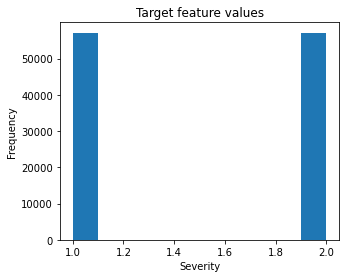

In [9]:
df_balanced.SEVERITYCODE.plot.hist(figsize=(5,4))
plt.title('Target feature values')
plt.xlabel('Severity')
plt.ylabel('Frequency')
print('Accidents classified in each level of severity:')
print(df_balanced['SEVERITYCODE'].value_counts())

As we can see now that we have a balanced dataset the severity codes are equally distributed, the two severity indicators points towards the below descriptions.

| Severity Code | Description | Incident Count |
| :---          | :---:       | :--   |
| 1             | Property Damage Only Collision | 57118 |
| 2             | Injury Collision | 57118

## 6. Yearly Incident Count

Text(0.5, 1.0, 'Annual Traffic Incidents in Seattle - by Severity')

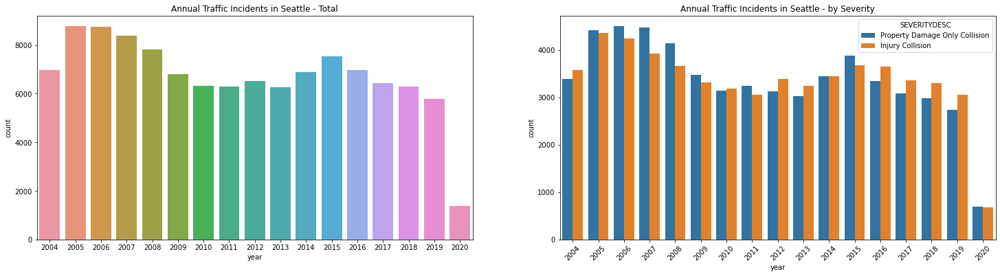

In [10]:
# Bar chart visualizatin of annual amount of traffic incidents in Seattle

fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(25, 6))

df_balanced['year'] = pd.DatetimeIndex(df_balanced['INCDATE']).year
df_balanced['year'].value_counts().sort_index()
sns.countplot(x="year", data=df_balanced, ax=ax1)
plt.xticks(rotation=45)
sns.countplot(x="year", hue="SEVERITYDESC", data=df_balanced, ax=ax2)
plt.xticks(rotation=45)
ax1.set_title('Annual Traffic Incidents in Seattle - Total')
ax2.set_title('Annual Traffic Incidents in Seattle - by Severity')

Looking at the above two graphs we are able to see the frequency of traffic incidents in Seattle by year, there is a significant drop in the year 2020 however in earlier years there is some difference between the years 2008-2014 where the count is nearing the 7000 mark.

The highest number of recorded incidents happened in 2006 which also recorded the highest number in property damage, one point to be noted is that during 2020 most of the world is going through a pandemic and so the number of people driving cars could be significantly lower than in the last decade.

## 7. Weather Conditions

In [11]:

df_balanced['WEATHER'].value_counts().sort_index()

Blowing Sand/Dirt              32
Clear                       67017
Fog/Smog/Smoke                349
Overcast                    16645
Partly Cloudy                   5
Raining                     20084
Severe Crosswind               17
Sleet/Hail/Freezing Rain       56
Snowing                       486
Name: WEATHER, dtype: int64

With the above count we are able to tell that the most number of accidents have happened in clear weather, what remains to be seen is the conditions of the roads in this clear weather as well as the severity of the accidents.

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 [Text(0, 0, 'Clear'),
  Text(1, 0, 'Raining'),
  Text(2, 0, 'Overcast'),
  Text(3, 0, 'Snowing'),
  Text(4, 0, 'Fog/Smog/Smoke'),
  Text(5, 0, 'Sleet/Hail/Freezing Rain'),
  Text(6, 0, 'Blowing Sand/Dirt'),
  Text(7, 0, 'Severe Crosswind'),
  Text(8, 0, 'Partly Cloudy')])

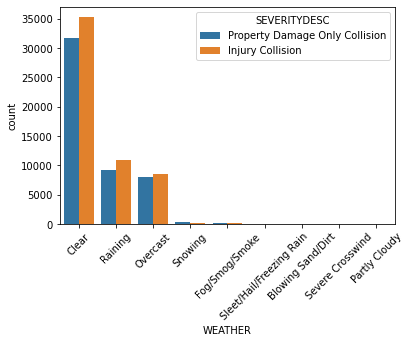

In [12]:
sns.countplot(x="WEATHER", hue="SEVERITYDESC", data=df_balanced)
plt.xticks(rotation=45)

## 8. Road Conditions

In [13]:
df_balanced['ROADCOND'].value_counts().sort_index()

Dry               75123
Ice                 661
Oil                  33
Sand/Mud/Dirt        35
Snow/Slush          526
Standing Water       58
Wet               28687
Name: ROADCOND, dtype: int64

(array([0, 1, 2, 3, 4, 5, 6]),
 [Text(0, 0, 'Dry'),
  Text(1, 0, 'Wet'),
  Text(2, 0, 'Ice'),
  Text(3, 0, 'Snow/Slush'),
  Text(4, 0, 'Sand/Mud/Dirt'),
  Text(5, 0, 'Standing Water'),
  Text(6, 0, 'Oil')])

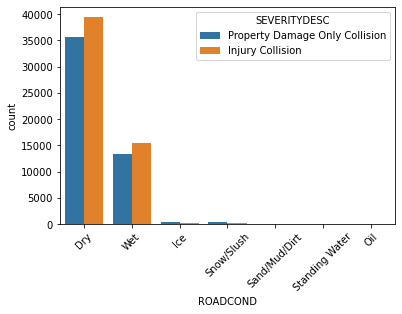

In [14]:
sns.countplot(x="ROADCOND", hue="SEVERITYDESC", data=df_balanced)
plt.xticks(rotation=45)

With the help of the above graphs we are able to see the split in the severity description according to the road conditions, above the graph we can see that when there has been dry road conditions the most number of accidents have been recorded.
Another factor to take into consideration would be the driving at various light conditions, as it is drivers would be a little less concerned when roads are dry. This leads to the question.

Do the road and light conditions lead to safer driving?

(array([0, 1, 2, 3, 4, 5, 6]),
 [Text(0, 0, 'Dry'),
  Text(1, 0, 'Wet'),
  Text(2, 0, 'Ice'),
  Text(3, 0, 'Snow/Slush'),
  Text(4, 0, 'Sand/Mud/Dirt'),
  Text(5, 0, 'Standing Water'),
  Text(6, 0, 'Oil')])

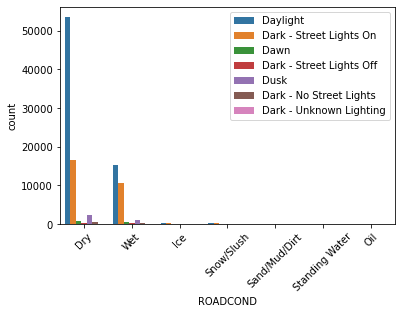

In [15]:
sns.countplot(x="ROADCOND", hue="LIGHTCOND", data=df_balanced)
plt.legend(loc='upper right')
plt.xticks(rotation=45)

To answer our above question, the graphs shows us that even in broad daylight we have the highest number of accidents on dry road conditions. This goes to show that even when the best driving conditions were present there were a signficant number of accidents.

## 9. Light Conditions

In [16]:
df_balanced['LIGHTCOND'].value_counts().sort_index()

Dark - No Street Lights       824
Dark - Street Lights Off      695
Dark - Street Lights On     28448
Dark - Unknown Lighting         6
Dawn                         1497
Daylight                    70664
Dusk                         3557
Name: LIGHTCOND, dtype: int64

Using just our light condition variable we can see that the highest number of accidents recorded have happened in daylight.

(array([0, 1, 2, 3, 4, 5, 6]),
 [Text(0, 0, 'Daylight'),
  Text(1, 0, 'Dark - Street Lights On'),
  Text(2, 0, 'Dawn'),
  Text(3, 0, 'Dark - Street Lights Off'),
  Text(4, 0, 'Dusk'),
  Text(5, 0, 'Dark - No Street Lights'),
  Text(6, 0, 'Dark - Unknown Lighting')])

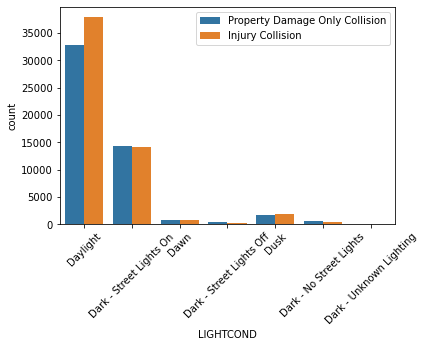

In [17]:
sns.countplot(x="LIGHTCOND", hue="SEVERITYDESC", data=df_balanced)
plt.legend(loc='upper right')
plt.xticks(rotation=45)

The above breakdown shows us the severity split in this light condition and severity comparison. As we can see there is a higher number of collision injury than property damage collision.

## 10. Location Area

In [18]:
#!pip install folium==0.11.0
import folium
from folium import plugins

In [19]:
# creates and displays Seattle map
latitude = df_balanced['Y'].mean()
longitude = df_balanced['X'].mean()
seattle_map = folium.Map(location=[latitude, longitude], zoom_start=12)

# add a mark for the incidents in the dataframe
incidents = plugins.MarkerCluster().add_to(seattle_map)

# loop through the dataframe and add each data point to the mark cluster
for lat, lng in zip(df_balanced.Y, df_balanced.X):
    if ~np.isnan(lat) and ~np.isnan(lng):
        folium.Marker(
            location=[lat, lng],
            icon=None,
        ).add_to(incidents)

# add incidents to map
seattle_map.add_child(incidents)

seattle_map

# 11. Methodology


We will use limited number of features as attributes for our model to classify SEVERITYCODE. Selected features are:

 - WEATHER
 - ROADCOND
 - LIGHTCOND
 - location (X)
 - location (Y)

Next we will split the data for to training and test groups with 80% of samples fo training and 20% for testing.

Finally in our analysis will be calculation and exploration of different models to find out the main problem for severity. We will use 4 classification models which are Logistic Regression, Decision Tree, KNN and SVM. After obtaining each model's predictions we will evaluate their accuracy, precison, f1-score, log-loss and compare and discuss the results.

# 12. Train & Test

### Encoding Labels

In [20]:
from sklearn.preprocessing import LabelEncoder

X = df_balanced[['WEATHER', 'ROADCOND', 'LIGHTCOND', 'SPEEDING', 'X', 'Y']]
X = pd.concat([X,pd.get_dummies(df_balanced[['WEATHER', 'ROADCOND', 'LIGHTCOND']])], axis=1)
X.drop(['WEATHER', 'ROADCOND', 'LIGHTCOND'], axis = 1,inplace=True)

X.head()

,SPEEDING,X,Y,WEATHER_Blowing Sand/Dirt,WEATHER_Clear,WEATHER_Fog/Smog/Smoke,WEATHER_Overcast,WEATHER_Partly Cloudy,WEATHER_Raining,WEATHER_Severe Crosswind,...,ROADCOND_Snow/Slush,ROADCOND_Standing Water,ROADCOND_Wet,LIGHTCOND_Dark - No Street Lights,LIGHTCOND_Dark - Street Lights Off,LIGHTCOND_Dark - Street Lights On,LIGHTCOND_Dark - Unknown Lighting,LIGHTCOND_Dawn,LIGHTCOND_Daylight,LIGHTCOND_Dusk
30461,0,-122.305539,47.588076,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
11132,0,-122.355301,47.689837,0,0,0,0,0,1,0,...,0,0,1,0,0,0,0,0,1,0
26635,0,-122.343628,47.723211,0,0,0,0,0,1,0,...,0,0,1,0,0,0,0,0,1,0
37222,0,-122.384740,47.675287,0,1,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
21633,0,-122.353285,47.692412,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0


In [21]:
z = df_balanced['SEVERITYCODE'].values
z [0:5]

array([1, 2, 2, 1, 1])

In [22]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler

In [23]:
# test - small data sample
from sklearn.model_selection import train_test_split
X, X_notused, z, z_notused = train_test_split( X, z, test_size=0.90, random_state=2)
print ('new size:', X.shape,  z.shape)

new size: (11423, 26) (11423,)


In [24]:
# split to train/test set 80/20
from sklearn.model_selection import train_test_split
X_train, X_test, z_train, z_test = train_test_split( X, z, test_size=0.2, random_state=4)
print ('Train set:', X_train.shape,  z_train.shape)
print ('Test set:', X_test.shape,  z_test.shape)

Train set: (9138, 26) (9138,)
Test set: (2285, 26) (2285,)


### Data Normalisation

In [25]:
from sklearn import preprocessing
X= preprocessing.StandardScaler().fit(X).transform(X)
X[0:1]

/home/jupyterlab/conda/envs/python/lib/python3.6/site-packages/sklearn/preprocessing/data.py:625: DataConversionWarning: Data with input dtype uint8, float64, object were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
/home/jupyterlab/conda/envs/python/lib/python3.6/site-packages/ipykernel_launcher.py:2: DataConversionWarning: Data with input dtype uint8, float64, object were all converted to float64 by StandardScaler.
  


array([[-0.22896085, -1.61922411,  0.82509274,  0.        ,  0.84689309,
        -0.05382637, -0.41161972, -0.01323314, -0.47086222, -0.01323314,
        -0.02292449, -0.06001815,  0.72871669, -0.06630518, -0.01323314,
        -0.02647324, -0.0592791 , -0.01871613, -0.5874933 , -0.09678037,
        -0.07681123, -0.57334049,  0.        , -0.10433099, -1.28083783,
         5.77984658]])

## 13. Modelling

We will use the training set to build an accurate model. Then use the test set to report the accuracy of individual models. We will compare below poplular ML algorithms:

 - K Nearest Neighbor(KNN)
 - Decision Tree
 - Support Vector Machine
 - Logistic Regression

We will try to ensure best model settings, to select best parameters for the model using Grid search, i.e. testing different panaremeters, like different number of K neigbors, and selecting one with highest estimate accuracy.

## 14. K-Nearest Neighbor (KNN)

In [26]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics

Ks = 10
mean_acc = np.zeros((Ks-1))
std_acc = np.zeros((Ks-1))
ConfustionMx = [];
for n in range(1,Ks):
    
    #Train Model and Predict  
    neigh = KNeighborsClassifier(n_neighbors = n).fit(X_train,z_train)
    yhat=neigh.predict(X_test)
    mean_acc[n-1] = metrics.accuracy_score(z_test, yhat)

    
    std_acc[n-1]=np.std(yhat==z_test)/np.sqrt(yhat.shape[0])

mean_acc

array([0.53960613, 0.53610503, 0.54310722, 0.52472648, 0.53479212,
       0.53260394, 0.54573304, 0.53610503, 0.54792123])

In [27]:
neigh = KNeighborsClassifier(n_neighbors = Ks).fit(X_train,z_train)
neigh

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
           metric_params=None, n_jobs=None, n_neighbors=10, p=2,
           weights='uniform')

### Model Accuracy for Different Number of Neighbours

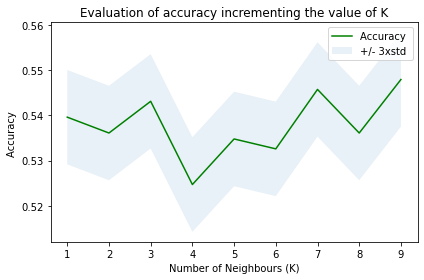

In [28]:
plt.plot(range(1,Ks),mean_acc,'g')
plt.fill_between(range(1,Ks),mean_acc - 1 * std_acc,mean_acc + 1 * std_acc, alpha=0.10)
plt.legend(('Accuracy ', '+/- 3xstd'))
plt.ylabel('Accuracy ')
plt.xlabel('Number of Neighbours (K)')
plt.title('Evaluation of accuracy incrementing the value of K')
plt.tight_layout()
plt.show()

In [29]:
print( "The best accuracy was with", mean_acc.max(), "with k=", mean_acc.argmax()+1) 

The best accuracy was with 0.5479212253829322 with k= 9


## 15. Decisions Trees

In [30]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
# select the best parameters
parameters = {'criterion':['gini','entropy']}
dTree_temp = DecisionTreeClassifier()
clf = GridSearchCV(dTree_temp, parameters)
clf.fit(X,z)

# train the best
dTree = DecisionTreeClassifier(criterion=clf.best_params_['criterion'])
dTree.fit(X,z)
dTree

/home/jupyterlab/conda/envs/python/lib/python3.6/site-packages/sklearn/model_selection/_split.py:2053: FutureWarning: You should specify a value for 'cv' instead of relying on the default value. The default value will change from 3 to 5 in version 0.22.
  warnings.warn(CV_WARNING, FutureWarning)


DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best')

## 16. Support Vector Machines

In [32]:
from sklearn import svm

# select the best parameters
parameters = {'kernel':['poly', 'rbf', 'sigmoid'],\
             'gamma':['scale', 'auto'],\
             'C':[1,0.1,0.01,0.001,0.0001]}
suppVM_temp = svm.SVC()
clf = GridSearchCV(suppVM_temp, parameters)
clf.fit(X,z)

# train the best
suppVM = svm.SVC(C=clf.best_params_['C'], kernel=clf.best_params_['kernel'], gamma = clf.best_params_['gamma'])
suppVM.fit(X,z)
suppVM

/home/jupyterlab/conda/envs/python/lib/python3.6/site-packages/sklearn/model_selection/_split.py:2053: FutureWarning: You should specify a value for 'cv' instead of relying on the default value. The default value will change from 3 to 5 in version 0.22.
  warnings.warn(CV_WARNING, FutureWarning)


SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
  max_iter=-1, probability=False, random_state=None, shrinking=True,
  tol=0.001, verbose=False)

## 17. Logistic Regression

In [31]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix

parameters = {'solver':('newton-cg', 'lbfgs', 'sag', 'saga'), 'C':[1,0.1,0.01,0.001,0.0001]}
LR = LogisticRegression()
clf = GridSearchCV(LR, parameters)
clf.fit(X,z)

LR_best = LogisticRegression(C=clf.best_params_['C'], solver=clf.best_params_['solver']).fit(X,z)
LR_best

/home/jupyterlab/conda/envs/python/lib/python3.6/site-packages/sklearn/model_selection/_split.py:2053: FutureWarning: You should specify a value for 'cv' instead of relying on the default value. The default value will change from 3 to 5 in version 0.22.
  warnings.warn(CV_WARNING, FutureWarning)
/home/jupyterlab/conda/envs/python/lib/python3.6/site-packages/sklearn/linear_model/sag.py:334: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)
/home/jupyterlab/conda/envs/python/lib/python3.6/site-packages/sklearn/linear_model/sag.py:334: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)
/home/jupyterlab/conda/envs/python/lib/python3.6/site-packages/sklearn/linear_model/sag.py:334: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  "the coef_ did not converge", ConvergenceWarning)
/home/j

LogisticRegression(C=0.01, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='warn',
          n_jobs=None, penalty='l2', random_state=None, solver='lbfgs',
          tol=0.0001, verbose=0, warm_start=False)

## 18. Model Evaluation

In [33]:
from sklearn.metrics import jaccard_similarity_score
from sklearn.metrics import f1_score
from sklearn.metrics import log_loss

In [34]:
#evaluate
# KNN
yhat_KNN =neigh.predict(X_test)

# Dtree
yhat_dTree = dTree.predict(X_test)

# SVM
yhat_svm = suppVM.predict(X_test)

#LR
yhat_LR = LR_best.predict(X_test)

In [35]:
# accuracy in df
ev_matrix = {'Algorithm':['KNN', 'Decision Tree', 'SVM', 'LogisticRegression'], \
             'Jaccard':[jaccard_similarity_score(z_test, yhat_KNN), \
                        jaccard_similarity_score(z_test, yhat_dTree), \
                        jaccard_similarity_score(z_test, yhat_svm), \
                        jaccard_similarity_score(z_test, yhat_LR) ], \
             'F-1 Score':[f1_score(z_test, yhat_KNN, average='weighted'), \
                        f1_score(z_test, yhat_dTree, average='weighted'), \
                        f1_score(z_test, yhat_svm, average='weighted'), \
                        f1_score(z_test, yhat_LR, average='weighted') ]} 
  
# Create df 
df_em = pd.DataFrame(ev_matrix) 
df_em.set_index('Algorithm',inplace=True)
df_em

/home/jupyterlab/conda/envs/python/lib/python3.6/site-packages/sklearn/metrics/classification.py:1143: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


,Jaccard,F-1 Score
Algorithm,,
KNN,0.541357,0.538635
Decision Tree,0.499781,0.333090
SVM,0.499781,0.333090
LogisticRegression,0.499781,0.333090


## 19. Results & Discussion

In this analysis we evaluated the performance of 4 machine learning algorithms on the Seattle Collision dataset to predict the severity of an accident by understanding the weather, road, light conditions and location. The three models performed very similary, but KNN stood out with a slightly higher F-1 score, but lower Jaccard index (lower accuacy). With KNN we were able to meet 54% accuracy and 50% accuracy with decision tree, SVM and Logistic Regression

## 20. Conclusion

The purpose of this project was explore and understand the relationship between traffic accident severity and various characteristics that give insight to the situation. From the available 38 features we have gone on to select just 5 that we feel summarise the relationship as best as possible.
An accuracy of 54% has been achieved and it is clear that the features that have been highlighted do have an impact on the severity of an accident.
There is scope for improvement provided that additional variables are available, these can be a mix of variables we already have and other external variables.
An example of this can be the last time of service, car safety features (for example air bags, anti lock breaks, electronic stability control, traction control).

# 21. References

1. World Health Organization (WHO). Global Status Report on Road Safety 2018. December 2018. [cited 2019 April 8]. Available from URL: https://www.who.int/violence_injury_prevention/road_safety_status/2018/en/external icon